In [10]:
from array import array

import numpy as np
import torch
from sklearn.utils import shuffle

from src.args import Args
from src.networks import VAE
from src.networks.maga_net import MAGANet
from src.registry import setup
from src.common.utils import set_seed
from src.dataset import DspritesDataset, get_dataloaders_2element

import matplotlib.pyplot as plt
# from sklearn.cluster import DBSCAN
from sklearn.manifold import TSNE
import umap
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
from sklearn.decomposition import PCA

import plotly.graph_objects as go

In [31]:
def encode_img(train_loader, test_loader, model, args):
    model.eval()  # Set model to evaluation mode

    latent_vir = []

    single_output = args.model_name == "vae"
    if single_output:
        for batch_idx, x1 in enumerate(test_loader):
            x1 = x1.to(args.device)  # Move tensors to GPU if available
            x, mu, logvar = model(x1)  # Forward pass
            z = model.reparameterize(mu, logvar)
            latent_vir.append(z.detach().cpu().numpy())

        for batch_idx, x1 in enumerate(train_loader):
            x1 = x1.to(args.device)  # Move tensors to GPU if available
            x, mu, logvar = model(x1)  # Forward pass
            z = model.reparameterize(mu, logvar)
            latent_vir.append(z.detach().cpu().numpy())
    else:
        for batch_idx, (x1, x2) in enumerate(test_loader):
            x1, x2 = x1.to(args.device), x2.to(args.device)  # Move tensors to GPU if available
            z, mu1, logvar1, mu2, logvar2, decoded_x1, decoded_x2  = model(x1, x2)  # Forward pass
            latent_vir.append(z.detach().cpu().numpy())

        for batch_idx, (x1, x2) in enumerate(train_loader):
            x1, x2 = x1.to(args.device), x2.to(args.device)  # Move tensors to GPU if available
            z, mu1, logvar1, mu2, logvar2, decoded_x1, decoded_x2  = model(x1, x2)  # Forward pass
            latent_vir.append(z.detach().cpu().numpy())

    z = np.vstack(latent_vir)
    np.save("../outputs/latent_vir", z)
    print("result saved")
    return

In [33]:
def generate_files(path):
    args = Args(file=f"{path}/hyperparameters.yaml")

    single_output = args.model_name == "vae"
    train_data = DspritesDataset("../data/2d/train.npz", single_output=single_output)
    test_data = DspritesDataset("../data/2d/test.npz", single_output=single_output)

    z_gt = np.concatenate([test_data.latents_values,train_data.latents_values])
    np.save("../outputs/latent_vir_gt", z_gt)
    print("ground truth latent value saved")

    train_loader, test_loader = get_dataloaders_2element(
        train_data, test_data,
        batch_size=args.batch_size,
        shuffle=False
    )

    if args.model_name == "maga":
        model = MAGANet(args)
        model.load_state_dict(torch.load(
            f"{path}/models/model_2element.pth"))
        model = model.to(args.device)
    elif args.model_name == "vae":
        model = VAE(args)
        model.load_state_dict(torch.load(
            f"{path}/models/model_2element.pth"))
        model = model.to(args.device)


    encode_img(train_loader, test_loader, model, args)
    return 

In [34]:
# generate_files("../outputs/run_dev_maga/seed_2_250320250829")
generate_files("../outputs/run_dev_vae/seed_2_240320252041")

ground truth latent value saved
result saved


In [35]:
z = np.load("../outputs/latent_vir.npy")
# z = np.load("./outputs/latent_vir_2range.npy")
z_gt = np.load("../outputs/latent_vir_gt.npy")

/home/amzi/Documents/DSAIT4125/dsait4125-cv/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



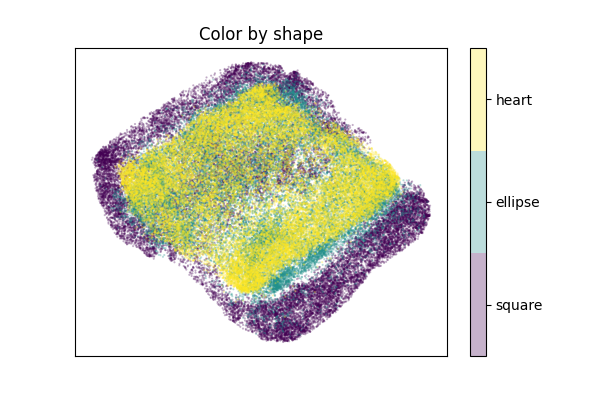

In [36]:
### use umap
## see shape
classes = ['square', 'ellipse', 'heart']
z1 = z[0:-1:10]
z_gt1 = z_gt[0:-1:10][:, 1].reshape(-1)  # shape
z_embedded = umap.UMAP(n_neighbors=50).fit_transform(z1)


fig, ax = plt.subplots(1, figsize=(6, 4))
plt.scatter(*z_embedded.T, s=0.3, c=z_gt1-1, alpha=0.3)
plt.setp(ax, xticks=[], yticks=[])
cbar = plt.colorbar(boundaries=np.arange(4) - 0.5, spacing='uniform')
cbar.set_ticks(np.array([0,1,2]))
cbar.set_ticklabels(classes)
plt.title("Color by shape")
plt.show()

In [38]:
# Sample Data (Replace with your actual data)
classes = ['square', 'ellipse', 'heart']
z1 = z[0:-1:10]
z_gt1 = z_gt[0:-1:10][:, 1].reshape(-1)
# Apply UMAP with 3 components for 3D visualization
z_embedded = umap.UMAP(n_neighbors=50, n_components=3).fit_transform(z1)

# Define discrete colors for classes
color_map = [0xfef7bd, 0xbcdddc, 0xc6b2cb]
colors = [color_map[int(i-1)] for i in z_gt1]

# Create 3D scatter plot
fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=z_embedded[:, 0],
    y=z_embedded[:, 1],
    z=z_embedded[:, 2],
    mode='markers',
    marker=dict(size=1, color=colors, opacity=0.3),  # Smaller points, more transparent
    text=[classes[int(i-1)] for i in z_gt1]  # Hover labels
))

fig.update_layout(title="Color by shape", scene=dict(bgcolor="white"))
fig.show()


/home/amzi/Documents/DSAIT4125/dsait4125-cv/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



In [22]:
## see position
z_gt1 = z_gt[0:-1:10][:, -2].reshape(-1) #pos_x
fig = px.scatter_3d(
    x=z_embedded[:, 0], 
    y=z_embedded[:, 1], 
    z=z_embedded[:, 2],
    color=z_gt1, 
    opacity=0.3,
    color_continuous_scale='viridis',
    labels={'color': 'Shape'},
    title='Color by pox_x'
)

fig.show()

In [23]:
## see position
z_gt1 = z_gt[0:-1:10][:, -1].reshape(-1)  #pos_y
fig = px.scatter_3d(
    x=z_embedded[:, 0],
    y=z_embedded[:, 1],
    z=z_embedded[:, 2],
    color=z_gt1,
    opacity=0.3,
    color_continuous_scale='viridis',
    labels={'color': 'Shape'},
    title='Color by pox_y'
)

fig.show()

In [25]:
## see scale
z_gt1 = z_gt[0:-1:10][:, 2].reshape(-1)  #scale
fig = px.scatter_3d(
    x=z_embedded[:, 0],
    y=z_embedded[:, 1],
    z=z_embedded[:, 2],
    color=z_gt1,
    opacity=0.1,
    color_continuous_scale='viridis',
    labels={'color': 'Shape'},
    title='Color by pox_y'
)

fig.show()

In [29]:
## see rotation
z_gt1 = z_gt[0:-1:10][:, 3].reshape(-1)  #orientation
fig = px.scatter_3d(
    x=z_embedded[:, 0],
    y=z_embedded[:, 1],
    z=z_embedded[:, 2],
    color=z_gt1,
    opacity=0.5,
    color_continuous_scale='hsv',
    labels={'color': 'Shape'},
    title='Color by pox_y'
)

fig.show()